In [4]:
# o código abaixa conecta o ambiente em execução com o Google Driver
#from google.colab import drive
#drive.mount('/content/drive')

import warnings
warnings.filterwarnings('ignore')

In [5]:
import pandas as pd

df = pd.read_csv('iml1_unidade1_dados.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

# Análise Descritiva

  0%|          | 0/3780 [00:00<?, ?it/s]

DataPrep Report
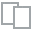
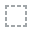
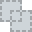
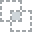
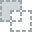
...
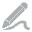
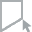
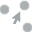
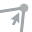
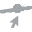

In [6]:
from dataprep.eda import create_report
create_report(df)

# Remoção Outlier

In [7]:
df['price'].quantile([
    0.0, 0.05, 0.1, 0.2, 0.3,  0.4,  0.5, 0.6, 0.7, 0.8, 0.9, 0.95, .97, 0.98, 0.99, 1],
    interpolation='lower')

0.00      75000.0
0.05     210000.0
0.10     245000.0
0.20     298450.0
0.30     345000.0
0.40     399500.0
0.50     450000.0
0.60     519000.0
0.70     595000.0
0.80     700000.0
0.90     887000.0
0.95    1156000.0
0.97    1388000.0
0.98    1600000.0
0.99    1960000.0
1.00    7700000.0
Name: price, dtype: float64

In [8]:
df[df['price'] >= 1960000].sort_values('price', ascending=False).head(70).iloc[0].to_dict()

{'id': 6762700020,
 'date': '20141013T000000',
 'price': 7700000.0,
 'bedrooms': 6,
 'bathrooms': 8.0,
 'sqft_living': 12050,
 'sqft_lot': 27600,
 'floors': 2.5,
 'waterfront': 0,
 'view': 3,
 'condition': 4,
 'grade': 13,
 'sqft_above': 8570,
 'sqft_basement': 3480,
 'yr_built': 1910,
 'yr_renovated': 1987,
 'zipcode': 98102,
 'lat': 47.6298,
 'long': -122.323,
 'sqft_living15': 3940,
 'sqft_lot15': 8800}

In [9]:
df = df[(df['bathrooms'] > 0)&(df['bedrooms'] > 0)&(df['price'] <= 1960000)]

# Análise Exploratória

In [10]:
import plotly.express as px

In [11]:
px.box(df, x='bathrooms', y='price')

In [12]:
px.scatter(df, x='sqft_living', y='price')

In [13]:
px.box(df, x='grade', y='price')

# Divisão dos dados

In [14]:
from sklearn.model_selection import train_test_split
df_train, df_test = train_test_split(df, test_size=0.3, random_state=0)

# Engenharia de recursos

In [18]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler

transformer = ColumnTransformer([
   ('one_hot',  OneHotEncoder(handle_unknown='ignore', sparse_output=False, min_frequency=0.01), ['zipcode']),
   ('numeric', MinMaxScaler(), ['bedrooms', 'bathrooms', 'sqft_living', 'grade', 'waterfront'])
  ])

In [19]:
X_train = transformer.fit_transform(df_train)
features = transformer.get_feature_names_out()
X_train = pd.DataFrame(X_train, columns=features)
X_test = pd.DataFrame(transformer.transform(df_test), columns=features)

In [20]:
y_train = df_train['price']
y_test = df_test['price']

# Seleção de modelos

In [21]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

def plot_coefs(features, coefs, n=20, split_by_sign=True):
    df = pd.DataFrame({'feature': features, 'coef': coefs})

    # Filtrando e ordenando os dados
    coefs_negativos = df.nsmallest(n, 'coef').loc[lambda df: df.coef < 0].sort_values('coef', ascending=False)
    coefs_positivos = df.nlargest(n, 'coef').loc[lambda df: df.coef >= 0].sort_values('coef', ascending=True)
    trace_positivo = go.Bar(
        y=coefs_positivos['feature'], x=coefs_positivos['coef'],
        orientation='h', marker=dict(color='blue'))
    # Criando o subplot
    if split_by_sign:
        fig = make_subplots(rows=1, cols=2, subplot_titles=('Coeficientes Negativos', 'Coeficientes Positivos'))
        fig.add_trace(
            go.Bar(
                y=coefs_negativos['feature'], x=coefs_negativos['coef'],
                orientation='h', marker=dict(color='red'),
                name='Coeficientes Negativos'),
            row=1, col=1)
        fig.add_trace(trace_positivo, row=1, col=2)
        width = 1200
    else:
        fig = make_subplots(rows=1, cols=1, subplot_titles=('Coeficientes'))
        fig.add_trace(trace_positivo, row=1, col=1)
        width = 600
    fig.update_layout(barmode='stack', showlegend=False, width=width, height=800)
    fig.show()


In [22]:
def plot_predict(y_test, y_predict):
  fig = px.scatter(pd.DataFrame({'Preço real': y_test, 'Preço predito': y_predict}), x='Preço real', y='Preço predito', width=600)
  fig.show()

In [23]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error

In [24]:
from sklearn import linear_model

## Regressão linear

In [25]:
linear = linear_model.LinearRegression(fit_intercept =True, positive=True).fit(X_train, y_train)

In [26]:
plot_coefs(features=features,  coefs=linear.coef_, split_by_sign=False)

In [27]:
plot_predict(y_test=y_test, y_predict=linear.predict(X_test))

In [28]:
{
    'Method': "Regressão Linear",
    'MSE': mean_squared_error(linear.predict(X_test), y_test),
    'MAE': mean_absolute_error(linear.predict(X_test), y_test),
    'MAPE': mean_absolute_percentage_error(linear.predict(X_test), y_test)
}

{'Method': 'Regressão Linear',
 'MSE': 19131834263.549515,
 'MAE': 95028.78551218346,
 'MAPE': 0.9144619539023175}

## Lasso

## Regressão linear

In [29]:
lasso = linear_model.LassoCV(fit_intercept=False, cv=10, positive=True).fit(X_train,y_train)

In [30]:
plot_coefs(features=features,  coefs=lasso.coef_, split_by_sign=False)

In [31]:
plot_predict(y_test=y_test, y_predict=lasso.predict(X_test))

In [32]:
{
    'Method': "Lasso",
    'MSE': mean_squared_error(lasso.predict(X_test), y_test),
    'MAE': mean_absolute_error(lasso.predict(X_test), y_test),
    'MAPE': mean_absolute_percentage_error(lasso.predict(X_test), y_test)
}

{'Method': 'Lasso',
 'MSE': 21895673618.237904,
 'MAE': 101406.55077936774,
 'MAPE': 0.1966068135450859}

In [33]:
X_test.iloc[0].to_dict()

{'one_hot__zipcode_98001': 0.0,
 'one_hot__zipcode_98003': 0.0,
 'one_hot__zipcode_98004': 0.0,
 'one_hot__zipcode_98006': 0.0,
 'one_hot__zipcode_98008': 0.0,
 'one_hot__zipcode_98022': 0.0,
 'one_hot__zipcode_98023': 0.0,
 'one_hot__zipcode_98027': 0.0,
 'one_hot__zipcode_98028': 0.0,
 'one_hot__zipcode_98029': 0.0,
 'one_hot__zipcode_98030': 0.0,
 'one_hot__zipcode_98031': 0.0,
 'one_hot__zipcode_98033': 0.0,
 'one_hot__zipcode_98034': 0.0,
 'one_hot__zipcode_98038': 0.0,
 'one_hot__zipcode_98040': 0.0,
 'one_hot__zipcode_98042': 0.0,
 'one_hot__zipcode_98045': 0.0,
 'one_hot__zipcode_98052': 0.0,
 'one_hot__zipcode_98053': 0.0,
 'one_hot__zipcode_98055': 0.0,
 'one_hot__zipcode_98056': 1.0,
 'one_hot__zipcode_98058': 0.0,
 'one_hot__zipcode_98059': 0.0,
 'one_hot__zipcode_98065': 0.0,
 'one_hot__zipcode_98072': 0.0,
 'one_hot__zipcode_98074': 0.0,
 'one_hot__zipcode_98075': 0.0,
 'one_hot__zipcode_98092': 0.0,
 'one_hot__zipcode_98103': 0.0,
 'one_hot__zipcode_98105': 0.0,
 'one_ho